In [1]:
import numpy as np
import pandas as pd
import tensorflow as tf

# 1. Load dataset

In [ ]:
df = pd.read_parquet("hf://datasets/google-research-datasets/go_emotions/raw")
df.to_csv('data/goemotions_raw.csv')

df.describe()

## 2. Preprocessing

In [28]:
from sklearn.model_selection import train_test_split
from collections import Counter
import seaborn as sns

In [17]:
cols = ['text', 'id']

emotions = [
    'admiration', 'amusement', 'anger', 'annoyance', 'approval', 'caring', 
    'confusion', 'curiosity', 'desire', 'disappointment', 'disapproval', 
    'disgust', 'embarrassment', 'excitement', 'fear', 'gratitude', 'grief', 
    'joy', 'love', 'nervousness', 'optimism', 'pride', 'realization', 'relief',
    'remorse', 'sadness', 'surprise', 'neutral'
]

cols.extend(emotions)

selected_labels = [
    'admiration', 'anger', 'annoyance', 'approval', 'confusion', 'disappointment', 
    'disapproval', 'excitement', 'fear', 'gratitude', 'love', 'realization',
    'anger', 'joy', 'sadness', 'optimism', 'surprise', 'neutral', 'curiosity'
]

df = df[cols]

print (f"Emotion label count: {len(emotions)}")

Emotion label count: 28


In [18]:
df = pd.melt(df, id_vars=['text', 'id'], value_vars=emotions, var_name='label').query('value == 1') 
df = df.drop_duplicates(subset=['id', 'label'])

del df['value']

**Label distribution**

<Axes: xlabel='label_id', ylabel='count'>

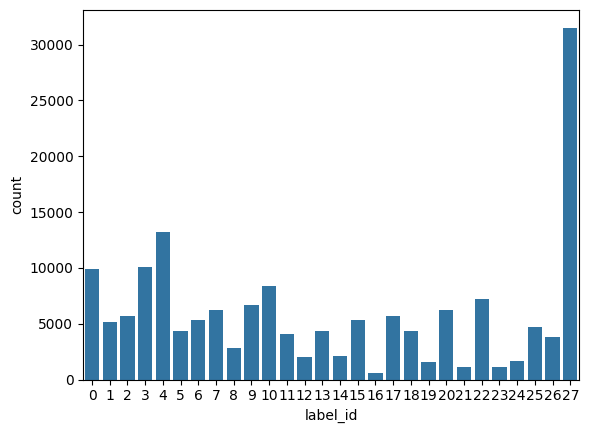

In [20]:
df['label_id'], labels = pd.factorize(df['label'])

num_classes = len(df['label_id'].unique())

sns.countplot(df, x='label_id')

The dataset is imbalanced.

This can bias the model towards majority classes and hurt minority class performance.

In [23]:
n_max = 5000

df = df.groupby('label').apply(lambda x: x.sample(n=min(n_max, len(x))))
df = df[df['label'].map(lambda x: x in selected_labels)]
df.head()

C:\Users\geolog\AppData\Local\Temp\ipykernel_13296\2591487288.py:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby('label').apply(lambda x: x.sample(n=min(n_max, len(x))))


text       id  \
label                                                                           
admiration 68928   Desperately miss this, [NAME] was one of my fa...  ef5bs6d   
           161032  He will but the Chiefs will absolutely have a ...  edxdht0   
           4283    I hear the ruler's control is remote and is vi...  ed43rft   
           112498  I had to look those up.lol. That's awesome. Do...  ed1m8rj   
           176277                           I am sports entertained.  ef4xo7w   

                        label  label_id  
label                                    
admiration 68928   admiration         0  
           161032  admiration         0  
           4283    admiration         0  
           112498  admiration         0  
           176277  admiration         0

<Axes: xlabel='label_id', ylabel='count'>

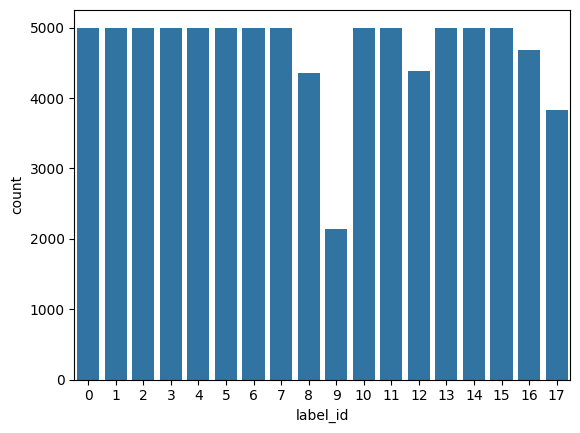

In [24]:
df['label_id'], labels = pd.factorize(df['label'])

num_classes = len(df['label_id'].unique())

sns.countplot(df, x='label_id')

In [26]:
df = df.reset_index(drop=True)

x = df['text']
y = df['label_id']

In [29]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42, stratify=y)

x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.2, random_state=42, stratify=y_train)

sorted(Counter(y_train).items())

[(0, 3200),
 (1, 3200),
 (2, 3200),
 (3, 3200),
 (4, 3200),
 (5, 3200),
 (6, 3200),
 (7, 3200),
 (8, 2787),
 (9, 1370),
 (10, 3200),
 (11, 3200),
 (12, 2805),
 (13, 3200),
 (14, 3200),
 (15, 3200),
 (16, 2993),
 (17, 2451)]

# 2. Fine-tune DistilBert

I will use `distil_bert_base_en_uncased`.

As there are multiple emotion lables in the dataset, it is a multiple class classification problem.\
`SparseCategoricalCrossentropy` will be used as a loss.

In [30]:
import keras_nlp
import keras

In [608]:
def preprocess_texts(texts):
    encoded = preprocessor(texts)
    return [encoded["token_ids"], encoded["padding_mask"]]

preprocessor = keras_nlp.models.DistilBertPreprocessor.from_preset(
    "distil_bert_base_en_uncased",
    sequence_length=512,
    name="emotions_preproc"
)

classifier = keras_nlp.models.DistilBertClassifier.from_preset(
    "distil_bert_base_en_uncased",
    num_classes=num_classes,
    preprocessor=preprocessor
)

classifier.backbone.trainable = True

classifier.compile(
    loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    optimizer=keras.optimizers.Adam(1e-5),
    metrics = ['accuracy']
)

classifier.fit(
    x=x_train, 
    y=y_train, 
    batch_size=16,
    epochs=2,
    validation_data = (x_val, y_val)
)

Epoch 1/2
3376/3376 [==============================] - 72936s 22s/step - loss: 2.3408 - accuracy: 0.2663 - val_loss: 2.1880 - val_accuracy: 0.3080
Epoch 2/2
3376/3376 [==============================] - 77908s 23s/step - loss: 2.1214 - accuracy: 0.3239 - val_loss: 2.1640 - val_accuracy: 0.3107


# 3. Evaluation

In [609]:
import matplotlib.pyplot as plt

In [610]:
classifier.evaluate(x=x_test, y=y_test, steps=3)

3/3 [==============================] - 39s 13s/step - loss: 2.1676 - accuracy: 0.2917


[2.1675806045532227, 0.2916666567325592]

In [611]:
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

def plot_confusion_matrix(y_pred, y_true, labels):
    cm = confusion_matrix(y_true, y_pred, normalize="true")
    _, ax = plt.subplots(figsize=(12, 12))
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    disp.plot(cmap="Blues", values_format=".2f", ax=ax, colorbar=False)
    plt.title("Normalized confusion matrix")
    plt.xticks(rotation=30)
    plt.show()
    plt.savefig('confusion_matrix.jpg')

In [612]:
y_pred = classifier.predict(x_test)

528/528 [==============================] - 6515s 12s/step


In [613]:
y_preds = np.argmax(y_pred, axis=1)

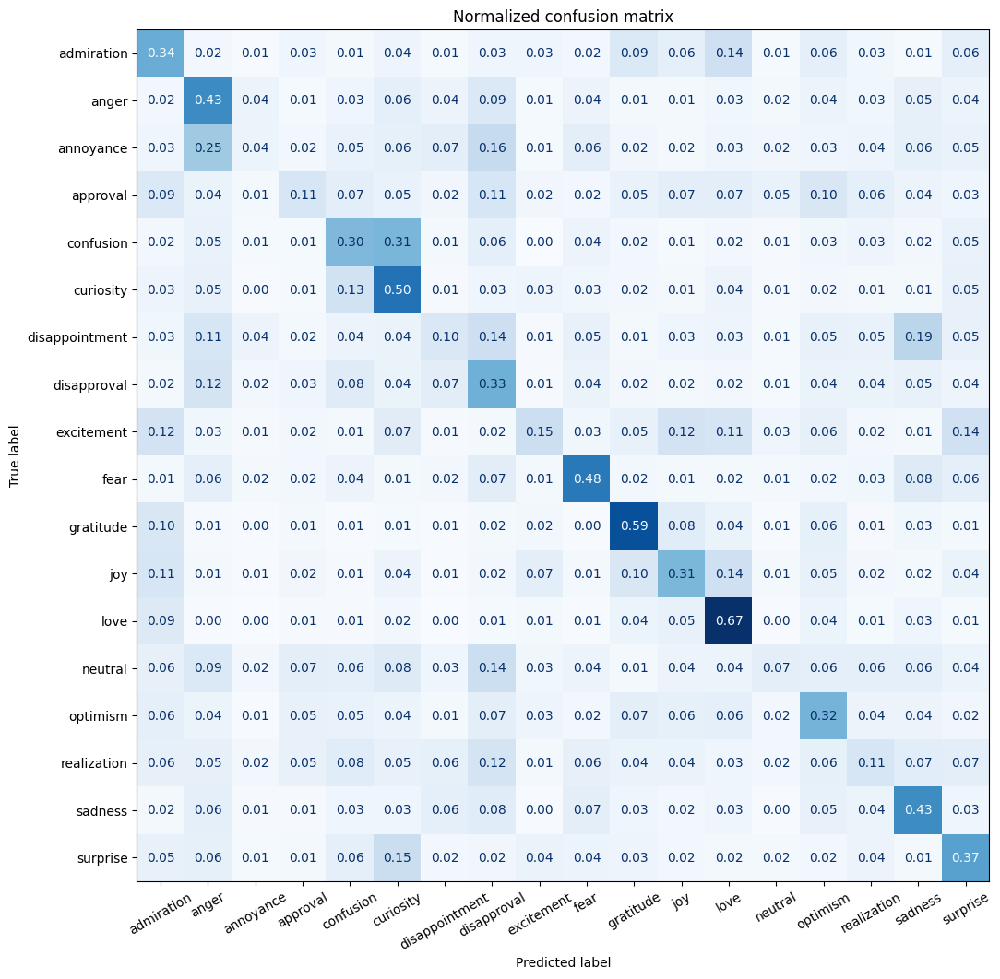

<Figure size 640x480 with 0 Axes>

In [614]:
plot_confusion_matrix(y_preds, y_test, labels)

# Text Analysis

In [33]:
def predict_top3_labels(texts):
    logits = classifier.predict(texts)
    probs = tf.nn.softmax(logits, axis=-1)
    
    # Get top 3 probabilities and their indices
    top_values, top_indices = tf.math.top_k(probs, k=3)
    
    # Convert TensorFlow tensors to numpy arrays
    top_probs = top_values.numpy()
    top_class_ids = top_indices.numpy()
    
    return list(zip(top_class_ids, top_probs))

In [34]:
for label_id, prob in predict_top3_labels(["That’s right."]):
    print (labels[label_id], prob)

1/1 [==============================] - 5s 5s/step
Index(['approval', 'neutral', 'realization'], dtype='object') [0.45306307 0.13861686 0.09548226]


## Debates 29.09.2020

In [35]:
label_id_to_label = {}
for i,label in enumerate(labels):
    label_id_to_label[i] = label

In [36]:
df_pred = pd.read_csv('data/us_election_2020_2nd_presidential_debate.csv')

df_pred.head()

,speaker,minute,text
0,Kristen Welker,00:18,"Good evening, everyone. Good evening. Thank yo..."
1,Donald Trump,07:37,How are you doing? How are you?
2,Kristen Welker,07:58,And I do want to say a very good evening to bo...
3,Kristen Welker,08:27,The goal is for you to hear each other and for...
4,Kristen Welker,09:03,… during this next stage of the coronavirus cr...


### Topic modeling

In [21]:
from bertopic import BERTopic
import tensorflow as tf
from bertopic.representation import KeyBERTInspired

In [31]:
representation_model = KeyBERTInspired()
topic_model = BERTopic(representation_model=representation_model)

topics, probs = topic_model.fit_transform(df_pred['text'].to_list())

In [23]:
df_pred['topic'] = topic_model.get_document_info(df_pred['text'].to_list())['Name']
df_pred.head()

,speaker,minute,text,topic
0,Kristen Welker,00:18,"Good evening, everyone. Good evening. Thank yo...",1_biden_vicepresident_vice_president
1,Donald Trump,07:37,How are you doing? How are you?,-1_immigration_trump_cages_president
2,Kristen Welker,07:58,And I do want to say a very good evening to bo...,1_biden_vicepresident_vice_president
3,Kristen Welker,08:27,The goal is for you to hear each other and for...,0_obamacare_healthcare_vaccine_insurance
4,Kristen Welker,09:03,… during this next stage of the coronavirus cr...,0_obamacare_healthcare_vaccine_insurance


In [33]:
topic_model.get_document_info(df_pred['text'].to_list()).to_csv('data/labeled/topic_model.csv')

In [24]:
sentiments = predict_top3_labels(df_pred['text'].tolist())

df_pred['top_labels'] = [labels for labels, probs in sentiments]
df_pred['top_probs'] = [probs for labels, probs in sentiments]

df_pred = df_pred.explode(['top_labels', 'top_probs'], ignore_index=True)

df_pred = df_pred.rename(columns={'top_labels': 'label', 'top_probs': 'prob'})

df_pred['sentiment'] = df_pred['label'].map(label_id_to_label)

16/16 [==============================] - 200s 12s/step


In [25]:
df_pred.to_csv('data/labeled/us_election_2020_2nd_presidential_debate_with_topics.csv')

# Explainer

In [37]:
import shap
import tensorflow as tf

In [38]:
def predict_proba(texts):

    logits = classifier.predict(texts)
    probs = tf.nn.softmax(logits, axis=-1)

    return probs

In [39]:
masker = shap.maskers.Text(r"\W")  # this will create a basic whitespace tokenizer
explainer = shap.Explainer(predict_proba, masker, output_names=labels)

1/1 [==============================] - 8s 8s/step


  0%|          | 0/110 [00:00<?, ?it/s]

1/1 [==============================] - 8s 8s/step


PartitionExplainer explainer: 2it [04:14, 254.28s/it]                                                                  


In [40]:
shap_values = explainer([' I used to live near that when I was growing up in Claymont, Delaware and there are more oil refineries in Marcus Hook and the Delaware River than there is any place, including in Houston at the time. When my mom get in the car and when there are first frost to drive me to school, turning the windshield wiper, there’d been oil slick in the window. That’s why so many people in my state were dying and getting cancer. The fact is those frontline communities, it’s not a matter of what you’re paying them. It matters how you keep them safe. What do you do? You impose restrictions on the pollutions that if the pollutants coming out of those fence line communities'])
shap.plots.text(shap_values)

1/1 [==============================] - 7s 7s/step


  0%|          | 0/498 [00:00<?, ?it/s]

1/1 [==============================] - 14s 14s/step


PartitionExplainer explainer: 2it [25:19, 1519.34s/it]                                                                 


In [41]:
text = 'When they put us in there, they did us a great disservice, they were going to take away our businesses. I will not sacrifice tens of millions of jobs, thousands and thousands of companies because of the Paris Accord, it was so unfair. China doesn’t kick in until 2030, Russia goes back to a low standard, and we kicked in right away, it would have been… It would have destroyed our businesses. So, you ready? We have done an incredible job environmentally, we have the cleanest air, the cleanest water, and the best carbon emission standards that we’ve seen in many, many years.'

shap_values = explainer([text])
shap.plots.text(shap_values)

1/1 [==============================] - 9s 9s/step


  0%|          | 0/498 [00:00<?, ?it/s]

1/1 [==============================] - 13s 13s/step


PartitionExplainer explainer: 2it [26:12, 1572.88s/it]                                                                 
